## **Define Functions for Training and Testing Models**

In [87]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning) # Ignore warnings

In [88]:
##################################################
# 1. Feature Selection, Scaling, Outliers Removal #
##################################################
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
import numpy as np
from scipy.stats import zscore

# Select features
def select_features(data, drop_columns):
    data = data.copy()

    feature_columns = list(data.columns)[:7]
    target_columns = list(data.columns)[7:]

    new_feature_columns = [col for col in feature_columns if col not in drop_columns]
    binary_target_columns = [col for col in target_columns if data[col].nunique() == 2]
    non_binary_target_columns = [col for col in target_columns if data[col].nunique() != 2]

    data = data[new_feature_columns + binary_target_columns + non_binary_target_columns]

    return data, new_feature_columns, target_columns, binary_target_columns, non_binary_target_columns

# Normalize features
def scale_features(data, feature_columns):
    data = data.copy()

    # Drop rows with missing values
    data = data.dropna()

    # Remove outliers
    data = remove_outlier(data, feature_columns)

    # Normalize features
    scaler = MinMaxScaler()
    data[feature_columns] = scaler.fit_transform(data[feature_columns])

    return data

def remove_outlier(data, feature_columns, threshold=2.5):
    data = data.copy()
    feature_data = data[feature_columns]
    z_scores = np.abs(feature_data.apply(zscore))  # Compute z-scores for each column
    is_outlier = (z_scores > threshold)  # Data out of 2.5 standard deviations
    outlier_rows = is_outlier.any(axis=1)  # Select rows with outliers

    outlier_indices = data.index[outlier_rows]
    data.drop(index=outlier_indices, inplace=True)

    return data

def convert_targets_non_binary_to_binary(data, non_binary_target_columns):
    data = data.copy()
    data.loc[:, non_binary_target_columns] = data[non_binary_target_columns].map(lambda x: 1 if x >= 3 else 0) # Define the presence of pain based on pain severity
    return data


In [89]:
###################################################
# 2. Define Dataset                               #
###################################################
from sklearn.model_selection import train_test_split

class dataset():
    def __init__(self, data, feature_columns, target_columns, test_size=0.2):
        self.data = data
        self.feature_columns = feature_columns
        self.target_columns = target_columns
        self.X_df = pd.DataFrame(data[feature_columns])
        self.y_df = pd.DataFrame(data[target_columns]).astype(int)
        self.X = self.X_df.values
        self.y = self.y_df.values
        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(self.X, self.y, test_size=test_size)
        
    def __len__(self):
        return len(self.X)
    
    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

In [90]:
###############################################################################
# 3. Tune Hyperparameters for Each Model for Each Target Column using Optuna  #
###############################################################################
from sklearn.metrics import accuracy_score, log_loss, roc_auc_score, average_precision_score, recall_score, f1_score, precision_score, precision_recall_curve, roc_curve
from optuna.samplers import TPESampler
from joblib import Parallel, delayed
from xgboost import XGBClassifier
import numpy as np
import optuna
import copy


# Find the decision threshold using youden's J Index
def find_optimal_threshold_youden_j(y_true, y_pred_proba):
    fpr, tpr, thresholds = roc_curve(y_true, y_pred_proba)
    specificity = 1 - fpr
    sensitivity = tpr  # recall
    youden_j = sensitivity + specificity - 1
    idx = np.argmax(youden_j)
    return thresholds[idx]


# Optuna objective function: A function to tune the hyperparameters of the XGBoost model for each target column
def objective_per_model(trial, idx, X_train, y_train, X_val, y_val, base_model):
    # Define hyperparameters to be tuned
    params = {
        'early_stopping_rounds': trial.suggest_int('early_stopping_rounds', 50, 100),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.15),
        'n_estimators': trial.suggest_int('n_estimators', 300, 800),
        'min_child_weight': trial.suggest_int('min_child_weight', 0, 10),
        'subsample': trial.suggest_float('subsample', 0.7, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.7, 1.0),
        'scale_pos_weight': trial.suggest_int('scale_pos_weight', 1, 5),
        'gamma': trial.suggest_float('gamma', 0, 2),
    }

    # Clone and configure the base model with the suggested parameters
    clf = copy.deepcopy(base_model)
    clf.set_params(**params)
    clf.fit(
        X_train, y_train[:, idx].ravel(),
        eval_set=[(X_train, y_train[:, idx].ravel()), (X_val, y_val[:, idx].ravel())],
        verbose=False
    )

    y_pred_proba = clf.predict_proba(X_val)[:, 1]
    y_val_true = y_val[:, idx]

    threshold = find_optimal_threshold_youden_j(y_val_true, y_pred_proba)
    y_pred = (y_pred_proba >= threshold).astype(int)  # Predictions based on the threshold

    # Calculate various evaluation metrics
    validation_accuracy = accuracy_score(y_val_true, y_pred)
    validation_recall = recall_score(y_val_true, y_pred)
    validation_precision = precision_score(y_val_true, y_pred)
    validation_f1_score = f1_score(y_val_true, y_pred)
    validation_auc_score = roc_auc_score(y_val_true, y_pred_proba)
    validation_aucpr_score = average_precision_score(y_val_true, y_pred_proba)

    train_log_loss = log_loss(y_train[:, idx], clf.predict_proba(X_train))
    val_log_loss = log_loss(y_val[:, idx], clf.predict_proba(X_val))

    train_log_loss_curve = clf.evals_result_['validation_0']['logloss']
    val_log_loss_curve = clf.evals_result_['validation_1']['logloss']
    precision_curve, recall_curve, pr_thresholds = precision_recall_curve(y_val_true, y_pred_proba)
    fpr, tpr, roc_thresholds = roc_curve(y_val_true, y_pred_proba)

    # Store evaluation metrics in the trial object for the analysis
    trial.set_user_attr("val_accuracy", validation_accuracy)
    trial.set_user_attr("recall", validation_recall)
    trial.set_user_attr("precision", validation_precision)
    trial.set_user_attr("f1_score", validation_f1_score)
    trial.set_user_attr("auc_score", validation_auc_score)
    trial.set_user_attr("aucpr_score", validation_aucpr_score)

    trial.set_user_attr("threshold", threshold)

    trial.set_user_attr("train_log_loss", train_log_loss)
    trial.set_user_attr("val_log_loss", val_log_loss)

    trial.set_user_attr("train_log_loss_curve", train_log_loss_curve)
    trial.set_user_attr("val_log_loss_curve", val_log_loss_curve)

    trial.set_user_attr("precision_curve", precision_curve)
    trial.set_user_attr("recall_curve", recall_curve)
    trial.set_user_attr("pr_thresholds", pr_thresholds)

    trial.set_user_attr("fpr", fpr)
    trial.set_user_attr("tpr", tpr)
    trial.set_user_attr("roc_thresholds", roc_thresholds)

    return validation_accuracy  # Metrics to optimize ( Change the metric to optimize to your need )


# Optimize individual model for each column
def optimize_single_model(idx, target_col, X_train, y_train, X_val, y_val, base_model, n_trials):
    sampler = TPESampler(seed=42 + idx)

    # Create study object. Change the direction(directions for multiple metrics to optimize) of the optimization(maximize/minimize)
    study = optuna.create_study(direction='maximize', sampler=sampler)

    # Optimize the objective function
    study.optimize(
        lambda trial: objective_per_model(
            trial, idx, X_train, y_train, X_val, y_val, base_model
        ),
        n_trials=n_trials
    )

    best_params = study.best_params
    best_score = study.best_value

    return study, best_params, best_score


# Train several models in parallel
def parameter_tuning_per_model_parallel(X_train, y_train, X_val, y_val, target_columns, base_models, prefix='', dir='./studies', n_trials=50):
    # Optimize individual model for each column by calling Optuna optimize function in parallel
    # Results contains a list of study objects(each containing trial object), best params(best param for each model), best scores(best score for each model)
    results = Parallel(n_jobs=-1, verbose=10)(
        delayed(optimize_single_model)(
            idx, target_col, X_train, y_train, X_val, y_val, base_models[idx], n_trials
        )
        for idx, target_col in enumerate(target_columns)  # Train each model in the order of target_columns
    )

    studies_per_model, best_params_per_model, best_scores_per_model = zip(*results)

    return studies_per_model, best_params_per_model, best_scores_per_model

In [91]:
# Get the best trial results
def get_train_result_df(studies, best_params, best_scores):
    best_trial_results = []
    best_trials = []
    for i, target_col in enumerate(target_columns):
        best_trial = studies[i].best_trial
        best_trials.append(best_trial)
        
        # build a dictionary to store the best trial results
        result = {
            'target_column': target_col,
            'best_accuracy': best_scores[i], # equal to studies[i].best_trial.user_attrs['val_accuracy']
            'best_recall': studies[i].best_trial.user_attrs['recall'],
            'best_f1_score': studies[i].best_trial.user_attrs['f1_score'],
            'best_auc': studies[i].best_trial.user_attrs['auc_score'],
            'best_aucpr': studies[i].best_trial.user_attrs['aucpr_score'],
            'best_threshold': studies[i].best_trial.user_attrs['threshold'],
            'best_precision': studies[i].best_trial.user_attrs['precision'],
            'best_recall': studies[i].best_trial.user_attrs['recall']
        }
        result.update(best_params[i])
        best_trial_results.append(result)

    best_trial_results_df = pd.DataFrame(best_trial_results)
    return best_trial_results_df, best_trials

Trial Early Stopping: https://github.com/optuna/optuna/issues/1001 

In [92]:
##################################################
# 4. Train and Save the Final Model               #
##################################################
from sklearn.base import BaseEstimator, ClassifierMixin, clone
import joblib
import copy
import os


# Define a wrapper class to keep respective models with different hyperparameters ( customized sklearn's MultiOutputClassifier )
class CustomMultiOutputClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self, estimators):
        # Initialize the list of estimators to be used for each target
        self.estimators = estimators

    def fit(self, X, Y):
        # Initialize a list to store models for each target. 
        # Different to sklearn's MultiOutputClassifier where all models are identical, this class keeps the models with different hyperparameters.
        self.models_ = []
        for i, est in enumerate(self.estimators):
            model = clone(est)
            model.fit(X, Y[:, i])
            self.models_.append(model)
        return self

    def predict(self, X):
        # Perform predictions for each model and stack the results column-wise
        preds = [model.predict(X) for model in self.models_]
        return np.column_stack(preds)

    def predict_proba(self, X):
        # Perform probability predictions for each model
        probas = []
        for model in self.models_:
            proba = model.predict_proba(X)
            # Handle special case for binary classification where output shape is (n_samples,)
            # The output shape is identical to sklearn's predict_proba output shape
            if proba.ndim == 1 or proba.shape[1] == 1:
                proba = np.vstack([1 - proba.ravel(), proba.ravel()]).T
            probas.append(proba)

        return probas


# Train the final model 
def train_final_model_multioutput(best_params, X_train, y_train, base_models):
    base_models = copy.deepcopy(base_models)
    
    # Remove early_stopping_rounds from best_params, because val_set is required for early stopping but val_set is not used for the final training.
    best_params = [
        {k: v for k, v in params.items() if k != 'early_stopping_rounds'}
        for params in best_params
    ]

    # Define CustomMultiOutputClassifier to save multiple models with different hyperparameters
    xgb_multi_clf = CustomMultiOutputClassifier(base_models)
    
    # Train the final model with the best parameters
    for idx, estimator in enumerate(xgb_multi_clf.estimators):
        estimator.set_params(**best_params[idx])
    xgb_multi_clf.fit(X_train, y_train)
    
    return xgb_multi_clf


def save_final_model(model, dir='./model', prefix=''):
    if not os.path.exists(dir):
        os.makedirs(dir)
    joblib.dump(model, os.path.join(dir, prefix + 'xgb_multi_clf.pkl'))
    print(f"Final model saved to {os.path.join(dir, prefix + 'xgb_multi_clf.pkl')}")

In [93]:
##################################################
# 5. Load the final model and test the model     #
##################################################
import os
import joblib
import numpy as np
import pandas as pd
from sklearn.metrics import accuracy_score, recall_score, f1_score, roc_auc_score, average_precision_score, classification_report

# Load the final model
def load_final_model(dir='./model', prefix=''):
    return joblib.load(os.path.join(dir, prefix + 'xgb_multi_clf.pkl'))


# Test the final model
def test_final_model_multioutput(xgb_multi_clf, dataset, best_trials, dir='./report', prefix=''):
    X_test, y_test = dataset.X_test, dataset.y_test
    target_columns = dataset.target_columns 
    
    # Get the predictions based on the threshold found during the hyperparameter tuning
    y_pred_proba = xgb_multi_clf.predict_proba(X_test)
    y_pred = np.zeros((len(X_test), len(target_columns)))
    for i in range (len(target_columns)):
        current_threshold = best_trials[i].user_attrs['threshold']
        y_pred[:, i] = (y_pred_proba[i][:, 1] >= current_threshold).astype(int)
    
    # Lists to store the test results 
    accuracies, recalls, precisions, f1_scores, auc_scores, aucpr_scores = [], [], [], [], [], []
    y_test_values, y_pred_values, y_pred_probas, classification_reports = [], [], [], []
    
    # Calculate the scores per target column
    for i in range(len(target_columns)):
        unique_labels = np.unique(y_test[:, i])
        labels = range(len(unique_labels))
        class_names = [str(label) for label in unique_labels]
        
        accuracies.append(accuracy_score(y_test[:, i], y_pred[:, i])) # append a column accuracy
        recalls.append(recall_score(y_test[:, i], y_pred[:, i]))
        precisions.append(precision_score(y_test[:, i], y_pred[:, i]))
        f1_scores.append(f1_score(y_test[:, i], y_pred[:, i]))
        auc_scores.append(roc_auc_score(y_test[:, i], y_pred_proba[i][:, 1]))
        aucpr_scores.append(average_precision_score(y_test[:, i], y_pred_proba[i][:, 1]))
        
        y_test_values.append(y_test[:, i])
        y_pred_values.append(y_pred[:, i])
        y_pred_probas.append(y_pred_proba[i][:, 1])
        classification_reports.append(classification_report(y_test[:, i], y_pred[:, i], target_names=class_names, labels=labels, zero_division=0))
        
    test_result_df = pd.DataFrame({
      'Target': target_columns,
      'Accuracy': accuracies,
      'Recall': recalls,
      'Precision': precisions,  
      'F1_Score': f1_scores,
      'AUC': auc_scores,
      'AUCPR': aucpr_scores,
      'F1_Score': f1_scores,
    })
    
    print(f"Mean Test Accuracy: {np.mean(accuracies):.4f}")
    print(f"Mean Test Recall: {np.mean(recalls):.4f}")
    print(f"Mean Test Precision: {np.mean(precisions):.4f}")
    print(f"Mean Test F1 Score: {np.mean(f1_scores):.4f}")
    print(f"Mean Test AUC: {np.mean(auc_scores):.4f}")
    print(f"Mean Test AUCPR: {np.mean(aucpr_scores):.4f}")
    
    results_dict = {
        "Metric": ["Mean Test Accuracy", "Mean Test Recall", "Mean Test Precision", "Mean Test F1 Score", "Mean Test AUC", "Mean Test AUCPR"],
        "Value": [np.mean(accuracies), np.mean(recalls), np.mean(precisions), np.mean(f1_scores), np.mean(auc_scores), np.mean(aucpr_scores)]
    }
    results_df = pd.DataFrame(results_dict)
    
    if not os.path.exists(dir):
        os.makedirs(dir)
    save_path_mean = os.path.join(dir, prefix + 'mean_test_scores.csv')
    save_path_df = os.path.join(dir, prefix + 'test_scores_per_target.csv')
    results_df.to_csv(save_path_mean, index=False)
    test_result_df.to_csv(save_path_df, index=False)
    
    return y_test_values, y_pred_values, y_pred_probas, test_result_df, classification_reports 

In [94]:
##################################################
# 6. Generate and Save Classification Reports     #
##################################################
import pandas as pd
from sklearn.metrics import accuracy_score
import os

# Save classification reports as csv file
def save_classification_reports(classification_reports, dataset, y_test_values, y_pred_values, dir='./report', prefix=''):
    reports_dict = {
        "Column": [],  # Target column name
        "Class": [],  # Class label
        "Precision": [],
        "Recall": [],
        "F1-score": [],
        "Support": [],
        "Accuracy": []
    }
    
    for i, report in enumerate(classification_reports):
        lines = report.split("\n")[2:-3]  # Remove headers and the last summary lines
        for line in lines:
            row = line.strip().split()
            
            # Ensure the row has at least 4 values and that the first value is a digit (class label)
            if len(row) >= 4 and row[0].isdigit():  
                reports_dict["Column"].append(dataset.target_columns[i])  # Target column name
                reports_dict["Class"].append(row[0])  # Class label
                reports_dict["Precision"].append(float(row[1]))
                reports_dict["Recall"].append(float(row[2]))
                reports_dict["F1-score"].append(float(row[3]))
                reports_dict["Support"].append(int(row[4]))

                # Calculate Accuracy for the specific class
                class_mask = (y_test_values[i] == int(row[0]))  # Samples corresponding to the specific class
                if class_mask.sum() > 0:  # Calculate only if samples for the class exist
                    class_accuracy = accuracy_score(y_test_values[i][class_mask], y_pred_values[i][class_mask])
                else:
                    class_accuracy = None  # Set Accuracy to None if no samples exist
                
                reports_dict["Accuracy"].append(class_accuracy)
    
    df_reports = pd.DataFrame(reports_dict)
    
    if not os.path.exists(dir):
        os.makedirs(dir)
    save_path = os.path.join(dir, prefix + 'classification_reports.csv')
    df_reports.to_csv(save_path, index=False)
    print(f"Classification reports saved to {save_path}")
    return df_reports


## **Define Functions to Visualize Results**

**Data Class Distribution Plots**
- Train Data Class Distribution
- Test Data Class Distribution 

In [95]:
##########################################################
# 7. Plot Class Distribution for the Training Data       # 
##########################################################
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_train_class_train_distribution(X_train, y_train, target_columns):
    y_train_df = pd.DataFrame(y_train, columns=target_columns)
    
    num_cols = 6  # Number of columns in the subplot grid
    num_rows = (len(target_columns) + num_cols - 1) // num_cols  # Adjust number of rows dynamically
    
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 5))
    axes = axes.flatten()
    
    for i, column in enumerate(target_columns):
        sns.countplot(x=column, data=y_train_df, ax=axes[i])
        axes[i].set_title(f'Class Distribution for {column}')
        axes[i].set_ylabel('Count')
        axes[i].grid(axis='y', linestyle='--', alpha=0.7)
    
    # Hide unused subplots if the number of target columns is not a multiple of num_cols
    for j in range(len(target_columns), len(axes)):
        fig.delaxes(axes[j])

    plt.suptitle('Class Distribution for the Final Training Set(Training Data)', y=1, fontsize=20, fontweight='bold')
    plt.tight_layout()

    return fig # Return fig to allow further manipulation or display

In [96]:
#######################################################################
# 8. Plot Class Distribution for Test Data  (Actual vs Predicted)     #
#######################################################################
import matplotlib.pyplot as plt
import numpy as np

def plot_class_distribution(y_test_values, y_pred_values, dataset):
    target_columns = dataset.target_columns
    num_cols = 6  # Number of columns in the subplot grid
    num_rows = (len(target_columns) + num_cols - 1) // num_cols  # Adjust number of rows dynamically

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 5))
    axes = axes.flatten()  # Flatten axes array for easy iteration

    for i, column in enumerate(target_columns):
        unique_classes = np.unique(np.concatenate([y_test_values[i], y_pred_values[i]]))  # Get all possible classes
        class_counts_test = {cls: np.sum(y_test_values[i] == cls) for cls in unique_classes}
        class_counts_pred = {cls: np.sum(y_pred_values[i] == cls) for cls in unique_classes}

        x_labels = list(unique_classes)
        y_test_counts = [class_counts_test[cls] for cls in unique_classes]
        y_pred_counts = [class_counts_pred[cls] for cls in unique_classes]

        width = 0.4  # Bar width
        x_indexes = np.arange(len(unique_classes))

        axes[i].bar(x_indexes - width / 2, y_test_counts, width=width, label='Actual', alpha=0.7)
        axes[i].bar(x_indexes + width / 2, y_pred_counts, width=width, label='Predicted', alpha=0.7)

        axes[i].set_xticks(x_indexes)
        axes[i].set_xticklabels(x_labels)
        axes[i].set_title(f'Class Distribution for {column}')
        axes[i].set_ylabel('Count')
        axes[i].legend()
        axes[i].grid(axis='y', linestyle='--', alpha=0.7)

    # Hide unused subplots if the number of target columns is not a multiple of num_cols
    for j in range(len(target_columns), len(axes)):
        fig.delaxes(axes[j])

    plt.suptitle('Class Distribution for Actual and Predicted Values per Target Column(Test Data)', y=1, fontsize=20, fontweight='bold')
    plt.tight_layout()

    return fig # Return fig to allow further manipulation or display

**Model Training Process Plots (Validation Data)**
- Optimization History (Optuna)
- Train-Validation Loss Curve 
- ROC Curve 
- Precision-Recall Curve
- Threshold vs Recall & Precision Curve 

In [97]:
#######################################################################
# 9. Optimization History Plot                                       #
#######################################################################
import optuna
import matplotlib.pyplot as plt
import plotly.io as pio
from io import BytesIO  # Import BytesIO to fix the NameError

def plot_optimization_histories(studies, target_columns):
    cols = 6  # Number of columns
    rows = (len(studies) + cols - 1) // cols  # Calculate number of rows

    fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 5*rows))
    axes = axes.flatten()

    for i, (study, ax) in enumerate(zip(studies, axes)):
        # Load optimization history plotly figure from optuna
        plotly_fig = optuna.visualization.plot_optimization_history(study)
        # Update the plotly figure
        plotly_fig.update_yaxes(title_text='Validation Accuracy')
        plotly_fig.update_layout(margin=dict(l=6, r=6, t=25, b=0), title_x=0.5)
        plotly_fig.update_layout(title_text=None) # Remove the existing title from plotly_fig
        plotly_fig.update_xaxes(title_font=dict(size=25), tickfont=dict(size=20))
        plotly_fig.update_yaxes(title_font=dict(size=25), tickfont=dict(size=20))
        plotly_fig.update_layout(legend=dict(font=dict(size=20)))
        plotly_fig.update_layout(legend=dict(x=0.7, y=0))
        
        # Plotly figure cannot directly be displayed in matplotlib
        # Convert plotly object to image and save it in the temporary buffer and plot the image in the subplot
        img_bytes = BytesIO(pio.to_image(plotly_fig, format='png'))
        img = plt.imread(img_bytes)
        ax.imshow(img)
        ax.set_title(f'{target_columns[i]}', fontsize=15)
        ax.axis('off')  # Hide the axis

    # Hide any remaining subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
        
    plt.suptitle('Optimization History for Each Target Column', y=0.985, fontsize=25, fontweight='bold')
    plt.tight_layout()

    return fig

In [98]:
#######################################################################
# 10. Train-Validation Loss Curve Plot                                #
#######################################################################
import matplotlib.pyplot as plt
import numpy as np

def plot_loss_curves(best_trials, target_columns):
    # get train and val log loss curves from the train result
    best_train_log_loss_curves = []
    best_val_log_loss_curves = []
    for i, trial in enumerate(best_trials):
        best_train_log_loss_curves.append(trial.user_attrs['train_log_loss_curve'])
        best_val_log_loss_curves.append(trial.user_attrs['val_log_loss_curve'])
        
    num_targets = len(target_columns)
    cols = 6
    rows = (num_targets + cols - 1) // cols  

    fig, axes = plt.subplots(rows, cols, figsize=(30, rows * 5))
    axes = axes.flatten()  # Flatten the axes array for easy iteration

    for i in range(num_targets):
        train_loss_curve = best_train_log_loss_curves[i]
        val_loss_curve = best_val_log_loss_curves[i]
        
        ax = axes[i]  # Get the current subplot
        ax.plot(train_loss_curve, label='Train Log Loss', color='blue')
        ax.plot(val_loss_curve, label='Val Log Loss', color='orange')

        ax.set_xlabel('Epoch')
        ax.set_ylabel('Log Loss')
        ax.set_title(f'{target_columns[i]}', fontsize=18)
        ax.legend()
        ax.grid(True)

    # Hide any unused subplots
    for j in range(num_targets, len(axes)):
        fig.delaxes(axes[j])

    plt.suptitle('Train vs Validation Log Loss for Each Target Column', y=1, fontsize=25, fontweight='bold')
    plt.tight_layout()
    
    return fig  # Return fig to allow further manipulation or display

In [99]:
#######################################################################
# 11. ROC Curve Plot                                                  #
#######################################################################
from sklearn.metrics import auc
import matplotlib.pyplot as plt

def plot_roc_curves(best_trials, target_columns):
    num_targets = len(target_columns)
    cols = 6
    rows = (num_targets + cols - 1) // cols 

    fig, axes = plt.subplots(rows, cols, figsize=(30, rows * 5))
    axes = axes.flatten()

    # Plot ROC Curve for best_trials
    for i, trial in enumerate(best_trials):
        ax = axes[i]
        fpr = trial.user_attrs['fpr']
        tpr = trial.user_attrs['tpr']
        roc_auc = auc(fpr, tpr)
        
        # Get the chosen threshold
        chosen_threshold = trial.user_attrs['threshold']
        roc_thresholds = trial.user_attrs['roc_thresholds']

        # Find the FPR, TPR corresponding to the chosen threshold
        chosen_idx = np.argmin(np.abs(roc_thresholds - chosen_threshold))
        chosen_threshold_fpr = fpr[chosen_idx]
        chosen_threshold_tpr = tpr[chosen_idx]

        # Mark the chosen threshold point
        ax.scatter(chosen_threshold_fpr, chosen_threshold_tpr, color='red', s=70, label=f'Chosen Threshold={chosen_threshold:.2f}', edgecolors='black', zorder=5)
        ax.plot([chosen_threshold_fpr, chosen_threshold_fpr], [0, chosen_threshold_tpr], color='black', linestyle='dashed', alpha=0.7, linewidth=0.5)
        ax.plot([0, chosen_threshold_fpr], [chosen_threshold_tpr, chosen_threshold_tpr], color='black', linestyle='dashed', alpha=0.7, linewidth=0.5)

        # Draw ROC Curve
        ax.plot(fpr, tpr, color='orange', label=f'ROC curve (AUC = {roc_auc:.2f})')
        ax.plot([0, 1], [0, 1], color='grey', linestyle='--')  # Diagonal reference line
        ax.set_xlim([0.0, 1.0])
        ax.set_ylim([0.0, 1.05])
        ax.set_xlabel("False Positive Rate", fontsize=12)
        ax.set_ylabel("True Positive Rate", fontsize=12)
        ax.set_title(f"{target_columns[i]}", fontsize=18)
        ax.legend(loc="lower right")

    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.suptitle('ROC Curve for Each Target Column', y=1, fontsize=25, fontweight='bold')
    plt.tight_layout()

    return fig  # Return fig to allow further manipulation or display

In [100]:
#######################################################################
# 12. Precision-Recall Curve                                          #
#######################################################################
from sklearn.metrics import auc
import matplotlib.pyplot as plt
import numpy as np

def plot_precision_recall_curves(best_trials, target_columns):
    num_targets = len(target_columns)
    cols = 6
    rows = (num_targets + cols - 1) // cols 

    # Create subplots
    fig, axes = plt.subplots(rows, cols, figsize=(30, rows * 5))
    axes = axes.flatten()

    # Plot PR Curve for best_trials
    for i, trial in enumerate(best_trials):
        ax = axes[i]
        precision = trial.user_attrs['precision_curve'].ravel()
        recall = trial.user_attrs['recall_curve'].ravel()
        pr_thresholds = trial.user_attrs['pr_thresholds']
        pr_auc = auc(recall, precision)  # Calculate PR Curve AUC

        # Get the chosen threshold
        chosen_threshold = trial.user_attrs['threshold']

        # Find the precision and recall corresponding to the chosen threshold
        chosen_idx = np.argmin(np.abs(pr_thresholds - chosen_threshold))
        chosen_precision = precision[chosen_idx]
        chosen_recall = recall[chosen_idx]
        
        # Mark the chosen threshold point
        ax.scatter(chosen_recall, chosen_precision, color='red', s=70, label=f'Threshold={chosen_threshold:.2f}', edgecolors='black', zorder=5)
        ax.plot([chosen_recall, chosen_recall], [0, chosen_precision], color='black', linestyle='dashed', alpha=0.7, linewidth=0.5)
        ax.plot([0, chosen_recall], [chosen_precision, chosen_precision], color='black', linestyle='dashed', alpha=0.7, linewidth=0.5)

        # Plot PR Curve
        ax.plot(recall, precision, marker='.', color='blue', label=f'PR curve (AUC = {pr_auc:.2f})')
        ax.set_xlim([0.0, 1.0])
        ax.set_ylim([0.0, 1.05])
        ax.set_xlabel("Recall", fontsize=12)
        ax.set_ylabel("Precision", fontsize=12)
        ax.set_title(f"{target_columns[i]}", fontsize=18)
        ax.legend(loc="lower left")

    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.suptitle('Precision-Recall Curve for Each Target Column', y=1, fontsize=25, fontweight='bold')
    plt.tight_layout()
    
    return fig  # Return fig to allow further manipulation or display

In [101]:
################################################
# 13. Thresholds vs Precision, Recall curves   # 
################################################

def plot_thresholds_vs_precision_recall(best_trials, target_columns):
    from sklearn.metrics import auc
    import matplotlib.pyplot as plt

    num_targets = len(target_columns)
    cols = 6
    rows = (num_targets + cols - 1) // cols 

    fig, axes = plt.subplots(rows, cols, figsize=(30, rows * 5))
    axes = axes.flatten()

    # Plot Precision-Recall vs Threshold for best_trials
    for i, trial in enumerate(best_trials):
        if i >= len(axes):  # Stop if the number of subplots is exceeded
            break

        ax = axes[i]
        precision = trial.user_attrs['precision_curve']
        recall = trial.user_attrs['recall_curve']
        thresholds = trial.user_attrs['pr_thresholds']
        chosen_threshold = trial.user_attrs['threshold']

        # Plot precision, recall curves and mark the threshold used
        ax.plot(thresholds, precision[:-1], color='blue', label='Precision')  # precision has 1 less elements than thresholds
        ax.plot(thresholds, recall[:-1], color='red', label='Recall')  # recall has 1 less elements than thresholds
        ax.axvline(x=chosen_threshold, color='black', linestyle='--', label=f'Chosen Threshold: {chosen_threshold:.2f}')
        ax.set_xlabel("Thresholds", fontsize=12)
        ax.set_ylabel("Score", fontsize=12)
        ax.set_title(f"{target_columns[i]}", fontsize=18)
        ax.legend(loc="lower left")

    # Remove any unused subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.suptitle('Precision-Recall vs Threshold for Each Target Column', y=1, fontsize=25, fontweight='bold')
    plt.tight_layout()
    
    return fig  # Return fig to allow further manipulation or display

**Model Performance Analysis (Test Data)**
- Confusion Matrix

In [102]:
#######################################################################
# 14. Confusion Matrix Plot ( Test Data )                             #
#######################################################################
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from matplotlib.patches import Rectangle
import seaborn as sns

def plot_confusion_matrices(y_test_values, y_pred_values, target_columns):
    cols = 6
    # Calculate the number of rows needed
    rows = (len(target_columns) + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(30, 4 * rows))
    axes = axes.flatten()

    for i, ax in enumerate(axes):
        if i < len(target_columns):
            # Plot confusion matrix
            cm = confusion_matrix(y_test_values[i], y_pred_values[i])
            sns.heatmap(cm, annot=False, fmt='d', cmap='Blues', ax=ax,
                        cbar=False)
            
            # TN, FP, FN, TP 정의
            tn, fp, fn, tp = cm.ravel()
            labels = [[f'TN: {tn}', f'FP: {fp}'], [f'FN: {fn}', f'TP: {tp}']]
            
            # Add text annotations with TN, FP, FN, TP labels
            for j in range(cm.shape[0]):
                for k in range(cm.shape[1]):
                    # Determine text color based on cell background darkness
                    text_color = 'white' if cm[j, k] > cm.max() / 2 else 'black'
                    # Place text in center of cells with labels only
                    ax.text(k + 0.5, j + 0.5, labels[j][k],
                            ha="center", va="center",
                            color=text_color, fontsize=13, fontweight='bold')
            
            ax.set_title(f'{target_columns[i]}', fontsize=18)
            ax.set_xlabel('Predicted', fontsize=15)
            ax.set_ylabel('Actual', fontsize=15)
            ax.set_xticklabels(ax.get_xticklabels(), fontsize=13)
            ax.set_yticklabels(ax.get_yticklabels(), fontsize=13)
            
            # Add a black border around each confusion matrix
            width, height = cm.shape[1], cm.shape[0]
            rect = Rectangle((0, 0), width, height, fill=False, edgecolor='black', lw=2)
            ax.add_patch(rect)
        else:
            # Hide any unused subplots
            ax.axis('off')
    
    plt.suptitle('Confusion Matrices for Test Results', y=1, fontsize=25, fontweight='bold')
    plt.tight_layout()
    
    return fig  # Return fig to allow further manipulation or display



**Hyperparameter and Feature Importance Analysis**
- Feature Importance ( Based on Information Gain )
- Hyperparameter Importance Plot (Optuna)

In [103]:
#################################################################################
# 15. Feature Importance Analysis ( Final Model, XGBoost Feature Importance )   #
#################################################################################
import matplotlib.pyplot as plt
import numpy as np

def plot_feature_importance(final_xgb_multi_clf, dataset):
    feature_columns = dataset.feature_columns
    target_columns = dataset.target_columns
    
    # Get the models from the final XGBoost multi-output classifier
    xgb_models = final_xgb_multi_clf.models_
    
    num_models = len(xgb_models)
    num_cols = 4
    num_rows = (num_models + num_cols - 1) // num_cols 
    
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(30, num_rows * 5))
    axes = axes.flatten()
    
    for i, model in enumerate(xgb_models):
        booster = model.get_booster()
        importance_dict = booster.get_score(importance_type='gain')

        # Sort the feature importance 
        feature_indices = [int(f.split('f')[1]) for f in importance_dict.keys()]
        mapped_feature_names = [feature_columns[idx] for idx in feature_indices]
        importance_values = np.array(list(importance_dict.values()))
        
        sorted_indices = np.argsort(importance_values)[::-1]
        sorted_features = [mapped_feature_names[idx] for idx in sorted_indices]
        sorted_importance = importance_values[sorted_indices]
        
        ax = axes[i]
        bars = ax.barh(sorted_features[::-1], sorted_importance[::-1], color='skyblue', height=0.5)
        ax.set_xlabel("Feature Importance (Gain)")
        ax.set_title(f'{target_columns[i]}', fontsize=15)
        
        ax.tick_params(axis='y', labelsize=13)
        ax.tick_params(axis='x', labelsize=13)
        
        # Display the values at the end of the bar
        for bar, value in zip(bars, sorted_importance[::-1]):
            ax.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{value:.2f}', 
                    va='center', ha='left', fontsize=10, color='black')
    
    # Hide empty subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
         
    plt.suptitle('Feature Importance for Each Target Column', y=1, fontsize=25, fontweight='bold')
    plt.tight_layout()
    
    return fig  # Return fig to allow further manipulation or display

In [104]:
#######################################################################
# 16. Hyperparameter Importance Plot (Optuna)                         #
#######################################################################
import matplotlib.pyplot as plt
import plotly.io as pio
from io import BytesIO

def plot_hyperparameter_importance(studies, target_columns):
    cols = 4  
    rows = (len(studies) + cols - 1) // cols  

    fig, axes = plt.subplots(rows, cols, figsize=(30, rows * 5))
    axes = axes.flatten()

    for i, (study, ax) in enumerate(zip(studies, axes)):
        plt.sca(ax)  # Set current axis
        
        fig = optuna.visualization.plot_param_importances(study)  # Return plotly object, which cannot be displayed with matplotlib
        fig.update_layout(title=f'Hyperparameter Importance for {target_columns[i]}')
        fig.update_layout(margin=dict(l=5, r=5, t=30, b=0), title_x=0.7)  # Adjust plotly margin and title position
        
        img_bytes = BytesIO(pio.to_image(fig, format='png'))  # Convert plotly object to image and save it in the temporary buffer
        img = plt.imread(img_bytes)
        ax.imshow(img)
        ax.axis('off')  # Hide the axis

    # Hide any remaining subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
        
    plt.suptitle('Hyperparameter Importance for Each Target Column', y=1.005, fontsize=25, fontweight='bold')
    plt.tight_layout()
    plt.show()

    return fig  # Return fig to allow further manipulation or display

**Impact of Feature Values on the Predictions ( Model Interpretation )**
- SHAP - Summary Plot
- SHAP - Summary Plot (Data within 1st and 3rd quantile)
- SHAP - Dependence Plot

In [105]:
#######################################################################
# 17. SHAP Summary Plot (Feature Impact on the Prediction (log odds)) #
#######################################################################
import shap
import matplotlib.pyplot as plt

def plot_shap_summary(dataset, final_xgb_multi_clf, best_trials):
    num_targets = len(dataset.target_columns)
    cols = 4
    rows = (num_targets + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(30, 30))
    axes = axes.flatten()

    for i, target_column in enumerate(dataset.target_columns):
        # Create SHAP explainer for the model
        explainer = shap.TreeExplainer(final_xgb_multi_clf.models_[i])
        explanation = explainer(dataset.X_test) 
        explanation.feature_names = dataset.feature_columns

        threshold = best_trials[i].user_attrs['threshold']
        log_odds = np.log(threshold / (1 - threshold))

        plt.sca(axes[i])  # Set current axis
        shap.summary_plot(
            explainer.shap_values(dataset.X_test),
            pd.DataFrame(dataset.X_test, columns=dataset.feature_columns),
            show=False,  # False: the plot is returned as axes object and can be drawn on the current axis
            plot_type="dot"  # dot: beeswarm plot, bar: mean absolute SHAP value plot (SHAP feature importance)
        )
        
        # Adjust the summary plot size
        axes[i].figure.set_size_inches(30, 80)  
        
        # Add vertical line at log odds threshold
        line = axes[i].axvline(x=log_odds, color='black', linestyle='--', linewidth=3, zorder=3)
        axes[i].legend([line], [f'Log Odds ({log_odds:.2f})'], loc='upper center', bbox_to_anchor=(0.5, 1.05))
        axes[i].set_title(
            f'Target Column: {target_column}\n Threshold: {threshold:.2f}, Threshold (Log Odds): {log_odds:.2f}',
            fontsize=15,
            fontweight='bold',
            y=1.1
        )
        axes[i].set_xlabel('SHAP Value - Log Odds\n(Impact on the Prediction)', fontsize=15)
        axes[i].set_ylabel(None)
        axes[i].set_yticklabels(axes[i].get_yticklabels(), fontsize=15)
        
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.suptitle('SHAP Summary Plots for All Targets', fontsize=25, y=1, fontweight='bold')
    plt.tight_layout(h_pad=5)  # Adjust layout

    return fig  # Return fig to allow further manipulation or display

In [106]:
#######################################################################
# 18. SHAP Summary Plot ( Data within 1st and 3rd quantile )          # 
#######################################################################
import shap
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def plot_shap_IQR_summary(dataset, final_xgb_multi_clf, best_trials):
    num_targets = len(dataset.target_columns)
    cols = 4
    rows = (num_targets + cols - 1) // cols

    # Compute 24th and 75th quantiles for X_test features
    X_test_df = pd.DataFrame(dataset.X_test, columns=dataset.feature_columns)
    q25 = X_test_df.quantile(0.25)
    q75 = X_test_df.quantile(0.75)

    # Filter X_test: Keep values within the 25th-75th quantile range
    filtered_X_test = X_test_df[(X_test_df >= q25) & (X_test_df <= q75)].dropna()

    # If filtered_X_test is empty after filtering, use original dataset to avoid errors
    if filtered_X_test.empty:
        filtered_X_test = X_test_df

    fig, axes = plt.subplots(rows, cols, figsize=(30, 30))
    axes = axes.flatten()

    for i, target_column in enumerate(dataset.target_columns):
        # Create SHAP explainer for the model
        explainer = shap.TreeExplainer(final_xgb_multi_clf.models_[i])
        explanation = explainer(filtered_X_test) 
        explanation.feature_names = dataset.feature_columns

        plt.sca(axes[i])  # Set current axis
        shap.plots.beeswarm(explanation, show=False)  # Draw SHAP summary plot ( shap.summary_plot(... plot_type="beeswarm") )
        axes[i].set_title(f'Target Column: {target_column}', fontsize=15, fontweight='bold')
        axes[i].figure.set_size_inches(30, 80)  # Adjust beeswarm plot size

        threshold = best_trials[i].user_attrs['threshold']
        log_odds = np.log(threshold / (1 - threshold))
        # Add vertical line at log odds threshold
        line = axes[i].axvline(
            x=log_odds, 
            color='black', 
            linestyle='--', 
            linewidth=3,
            zorder=3  
        )

    # Turn off extra subplots
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    plt.suptitle('SHAP Summary Plots for All Targets (Filtered X_test: 25th-75th Quantile)', fontsize=25, y=1, fontweight='bold')
    plt.tight_layout(h_pad=5)  # Adjust layout
    
    return fig  # Return fig to allow further manipulation or display


In [107]:
#######################################################################
# 19. SHAP Dependence Plots                                           #
#######################################################################
import shap
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math

def plot_shap_dependence_plots(dataset, final_xgb_multi_clf, features):
    # Select features to analyze across all targets
    features_to_analyze = features
    X_test_df = pd.DataFrame(dataset.X_test, columns=features_to_analyze)

    # For each feature, create a separate figure with subplots for all targets
    for feature_to_analyze in dataset.feature_columns:
        feature_idx = dataset.feature_columns.index(feature_to_analyze)
        
        num_targets = len(dataset.target_columns)
        cols = 4
        rows = math.ceil(num_targets / cols)
        
        fig, axes = plt.subplots(rows, cols, figsize=(20, 4*rows))
        axes = axes.flatten()
        
        for i, target_column in enumerate(dataset.target_columns):
            model = final_xgb_multi_clf.models_[i]
            explainer = shap.TreeExplainer(model)
            shap_values_target = explainer.shap_values(X_test_df)
            
            plt.sca(axes[i])  # Set current axis
            shap.dependence_plot(feature_idx, shap_values_target, X_test_df, ax=axes[i], show=False)  # Plot dependence plot 
            axes[i].set_title(f'Target: {target_column}', fontsize=10, fontweight='bold')
        
        # Turn off extra subplots
        for j in range(i + 1, len(axes)):
            axes[j].axis('off')
        
        plt.suptitle(f'SHAP Dependence Plots for Feature: {feature_to_analyze} Across All Targets', 
                    fontsize=18, fontweight='bold', y=1)
        plt.tight_layout()
        plt.show()
        
    return fig  # Return fig to allow further manipulation or display

--- 

## **Function Execution**

In [108]:
prefix = '1_'  # Prefix for files and directories 

In [109]:
## 1. Load Data, Select Features, Scale Features, Convert Targets
data = pd.read_csv('data/anamnesis_translated.csv') 

drop_columns = []  # Columns to drop 
data, new_feature_columns, target_columns, binary_target_columns, non_binary_target_columns = select_features(data, drop_columns)
data = scale_features(data, new_feature_columns)
data = convert_targets_non_binary_to_binary(data, non_binary_target_columns)
# data.head()

In [110]:
## 2. Define Dataset 
dataset = dataset(data, new_feature_columns, target_columns, test_size=0.2)

In [111]:
## 3. Tune Hyperparameters for Each Model for Each Target Column using Optuna

# Define respective models for each target column
base_model = XGBClassifier(
        random_state=42, 
        objective='binary:logistic',
        # eval_metric='logloss',
        eval_metric='logloss',
        n_jobs=-1,
        enable_categorical=True
    ) 
base_models = [base_model for _ in range(len(target_columns))]

# Split the train date into training and validation sets 
X_train, X_val, y_train, y_val = train_test_split(dataset.X_train, dataset.y_train, test_size=0.2, random_state=42)

# Find the optimal hyperparameters for each model and get the best trials objects
studies, best_params, best_scores = parameter_tuning_per_model_parallel(
    X_train, y_train, X_val, y_val, target_columns, base_models, n_trials=100, prefix=prefix
    )

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[I 2025-03-01 23:37:58,327] A new study created in memory with name: no-name-e81e13ea-ea62-4c96-b28f-878aaf0e292d
[I 2025-03-01 23:37:58,614] Trial 0 finished with value: 0.5085324232081911 and parameters: {'early_stopping_rounds': 69, 'max_depth': 10, 'learning_rate': 0.11247915185359669, 'n_estimators': 599, 'min_child_weight': 1, 'subsample': 0.7467983561008608, 'colsample_bytree': 0.7174250836504598, 'scale_pos_weight': 5, 'gamma': 1.2022300234864176}. Best is trial 0 with value: 0.5085324232081911.
[I 2025-03-01 23:37:58,725] Trial 1 finished with value: 0.5699658703071673 and parameters: {'early_stopping_rounds': 86, 'max_depth': 3, 'learning_rate': 0.1457873793026792, 'n_estimators': 717, 'min_child_weight': 2, 'subsample': 0.7545474901621302, 'colsample_bytree': 0.7550213529560301, 'scale_pos_weight': 2, 'gamma': 1.0495128632644757}. Best is trial 1 with value: 0.5699658703071673.
[I 2025-03-01 23:37:58

In [112]:
## get the hyperparmeter tuning results: best trials objects  
best_trial_results_df, best_trials = get_train_result_df(studies, best_params, best_scores)
# best_trial_results_df

In [113]:
## 4. Train and Save the Final Model 
X_train, y_train = dataset.X_train, dataset.y_train  # Entire training set 
final_xgb_multi_clf = train_final_model_multioutput(best_params, X_train, y_train, base_models)
save_final_model(final_xgb_multi_clf, prefix=prefix)

Final model saved to ./model/1_xgb_multi_clf.pkl


In [114]:
## 5. Load the Final Model and Test the Model 
final_xgb_multi_clf = load_final_model(prefix=prefix)
y_test_values, y_pred_values, y_pred_probas, test_result_df, classification_reports = test_final_model_multioutput(final_xgb_multi_clf, dataset, best_trials, prefix=prefix)

Mean Test Accuracy: 0.6853
Mean Test Recall: 0.2230
Mean Test Precision: 0.3259
Mean Test F1 Score: 0.2389
Mean Test AUC: 0.5300
Mean Test AUCPR: 0.3035


In [115]:
test_result_df

,Target,Accuracy,Recall,Precision,F1_Score,AUC,AUCPR
0,Pain_Forefoot_Left,0.581967,0.405797,0.440945,0.422642,0.573036,0.447624
1,Pain_Forefoot_Right,0.612022,0.472868,0.451852,0.462121,0.589965,0.447975
2,Pain_Midfoot_Left,0.516393,0.508065,0.351955,0.415842,0.522861,0.362616
3,Pain_Midfoot_Right,0.661202,0.100000,0.428571,0.162162,0.572188,0.411431
4,Pain_Heel_Left,0.691257,0.164706,0.250000,0.198582,0.489470,0.250518
5,Pain_Heel_Right,0.721311,0.194444,0.241379,0.215385,0.500992,0.231545
6,Pain_Forehead,0.920765,0.050000,0.090909,0.064516,0.437139,0.061323
7,Pain_Crown,0.915301,0.000000,0.000000,0.000000,0.497675,0.075450
8,Pain_Neck_Muscles,0.532787,0.653846,0.524229,0.581907,0.566292,0.560650
9,Pain_Cervical_Spine,0.532787,0.163522,0.406250,0.233184,0.546380,0.463996


In [116]:
## 6. Generate and Save Classification Reports  
test_result_report_df = save_classification_reports(
    classification_reports, dataset, y_test_values, y_pred_values, prefix=prefix
) 
test_result_report_df

Classification reports saved to ./report/1_classification_reports.csv


,Column,Class,Precision,Recall,F1-score,Support,Accuracy
0,Pain_Forefoot_Left,0,0.66,0.69,0.67,228,0.688596
1,Pain_Forefoot_Left,1,0.44,0.41,0.42,138,0.405797
2,Pain_Forefoot_Right,0,0.71,0.69,0.70,237,0.687764
3,Pain_Forefoot_Right,1,0.45,0.47,0.46,129,0.472868
4,Pain_Midfoot_Left,0,0.67,0.52,0.59,242,0.520661
...,...,...,...,...,...,...,...
79,Pain_Thumb_Right,1,0.37,0.20,0.26,71,0.197183
80,Pain_Forearm_Left,0,0.94,0.98,0.96,345,0.979710
81,Pain_Forearm_Left,1,0.12,0.05,0.07,21,0.047619
82,Pain_Forearm_Right,0,0.91,0.93,0.92,331,0.927492


---

#### **Training and Model Results Evaluation/Plots**

- **Data Class Distribution Plots**
    - Train Data Class Distribution
    - Test Data Class Distribution 

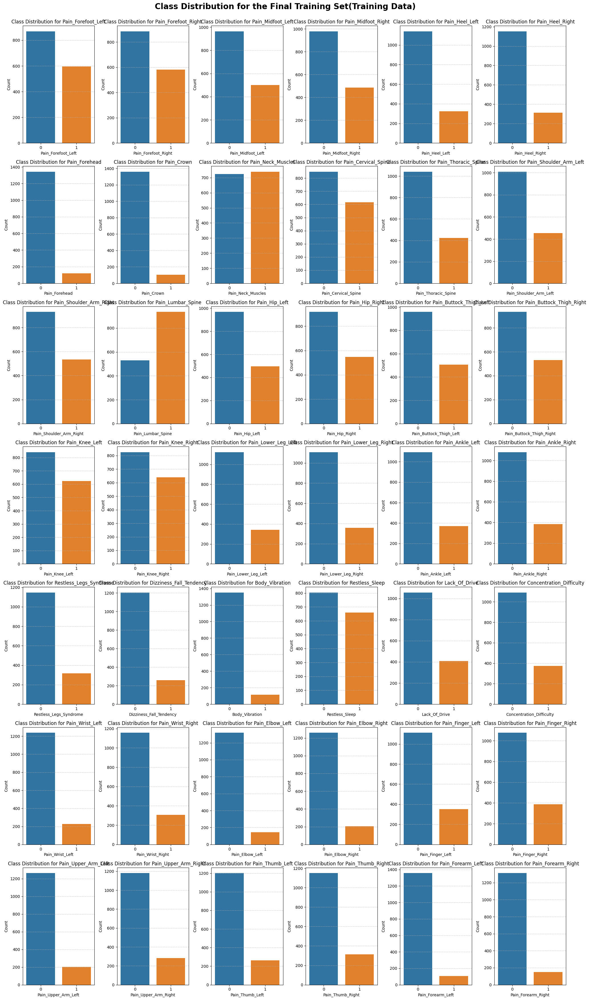

In [117]:
## 7. Plot Class Distribution for the Training Data       
X_train, y_train = dataset.X_train, dataset.y_train
train_distribution_fig = plot_train_class_train_distribution(X_train, y_train, dataset.target_columns)
# plt.close(train_distribution_fig)

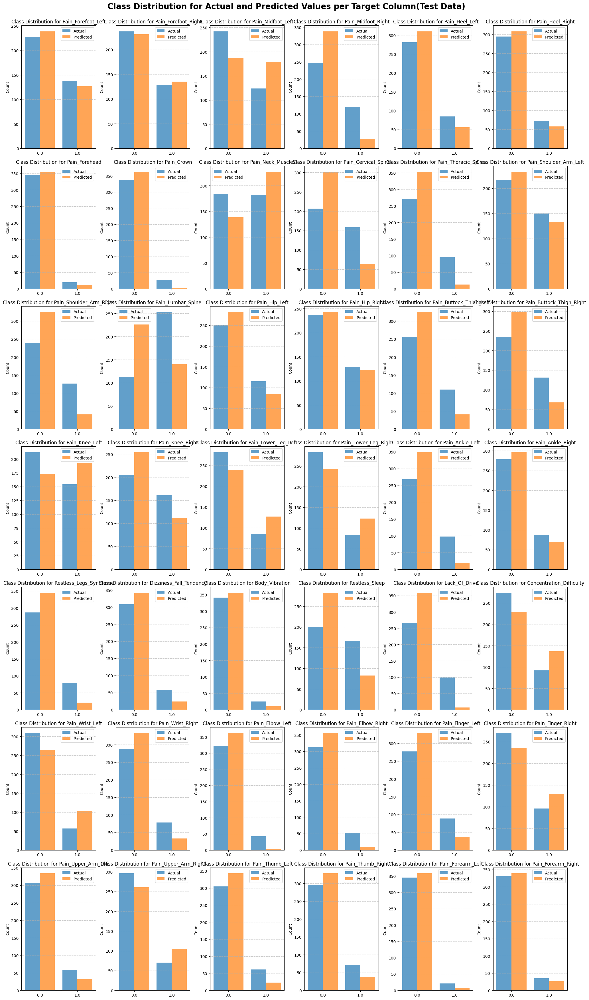

In [118]:
## 8. Plot Class Distribution for Test Data  (Actual vs Predicted)
test_distribution_fig = plot_class_distribution(y_test_values, y_pred_values, dataset) 
# plt.close(test_distribution_fig) # Prevent displying fig object automatically

- **Model Training Process Plots (Validation Data)**
    - Optimization History (Optuna)
    - Train-Validation Loss Curve 
    - ROC Curve 
    - Precision-Recall Curve
    - Threshold vs Recall & Precision Curve 

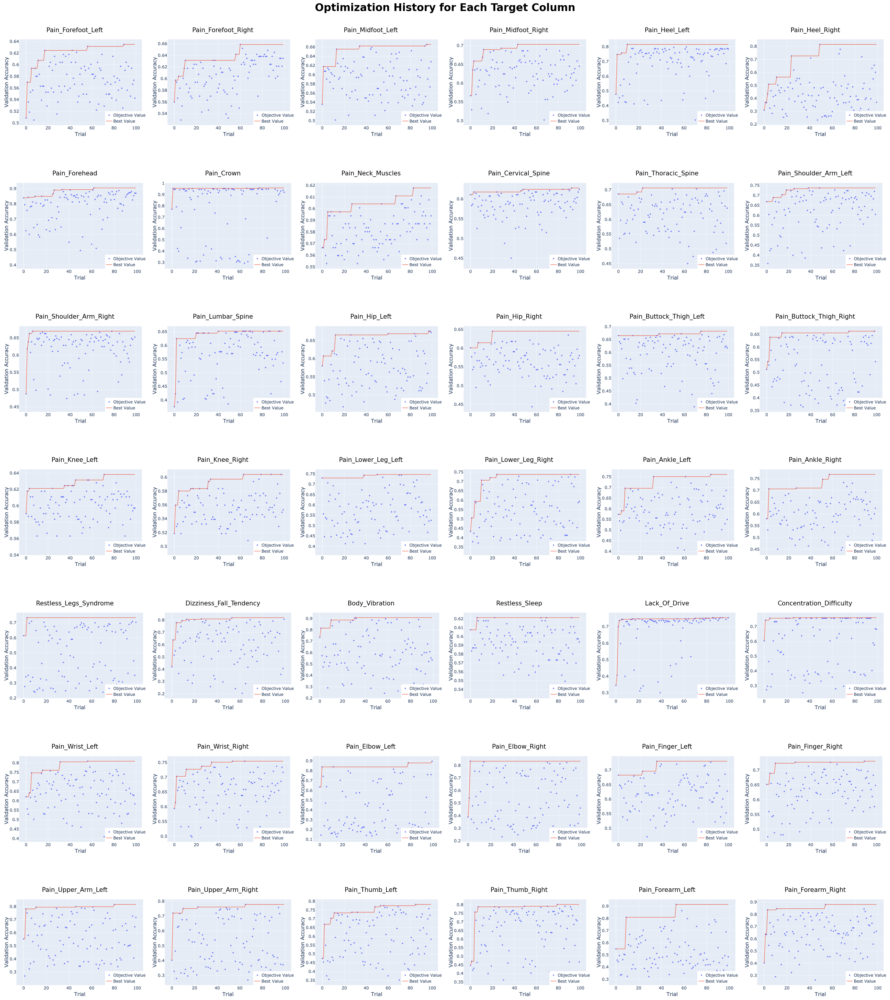

In [119]:
## 9. Optuna Optimization History ( Optuna ) - Check if the number of trials is enough  
optimization_history_fig = plot_optimization_histories(studies, dataset.target_columns)
# plt.close()

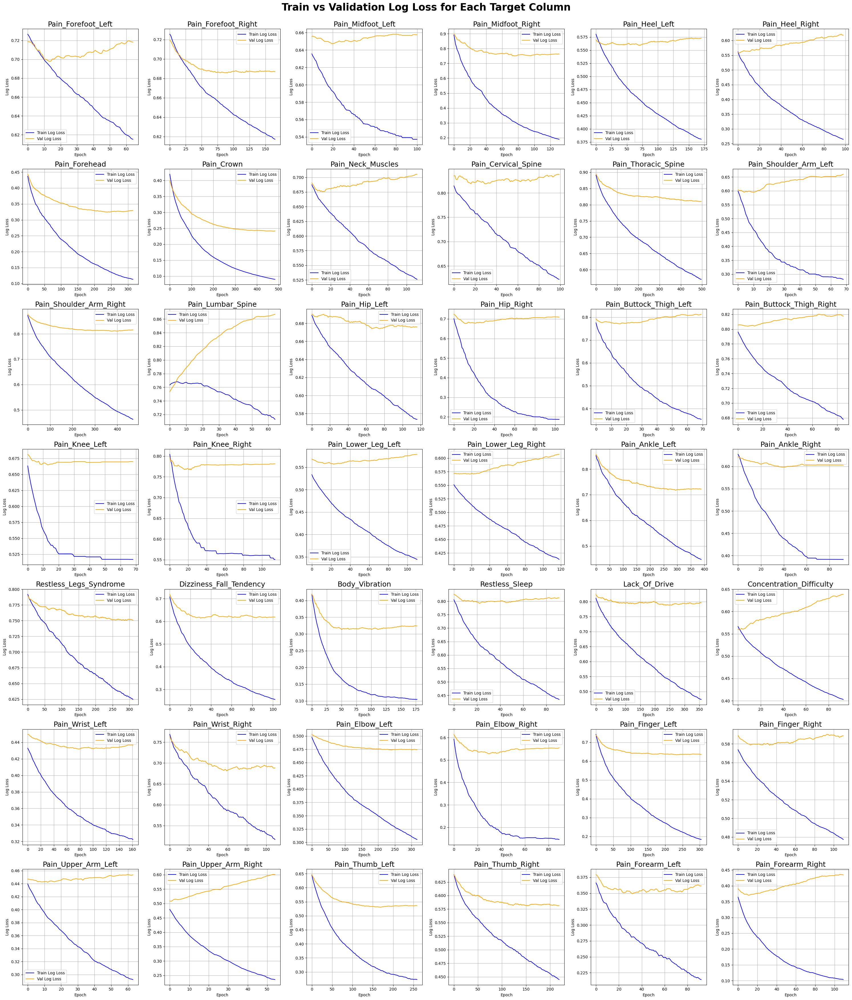

In [120]:
## 10. Train-Validation Loss Curve Plot                              
loss_curves_fig = plot_loss_curves(best_trials, target_columns)
# plt.close()

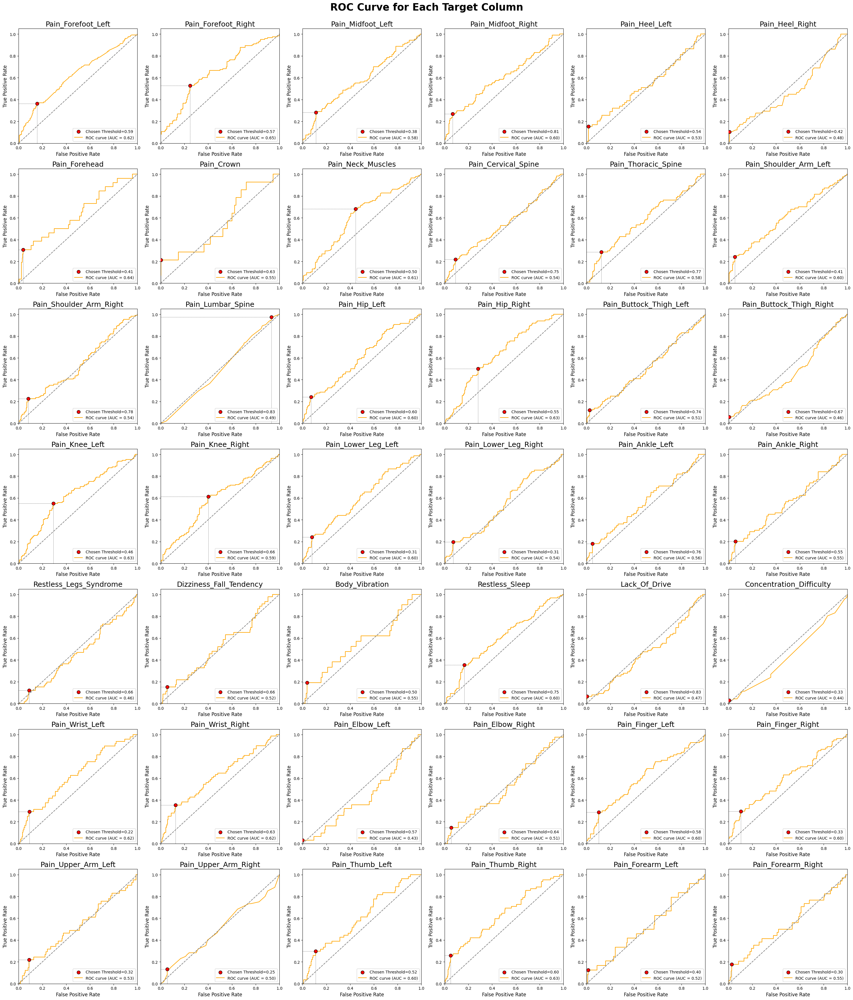

In [121]:
## 11. ROC Curve Plots 
roc_curves_fig = plot_roc_curves(best_trials, dataset.target_columns)
# plt.close()

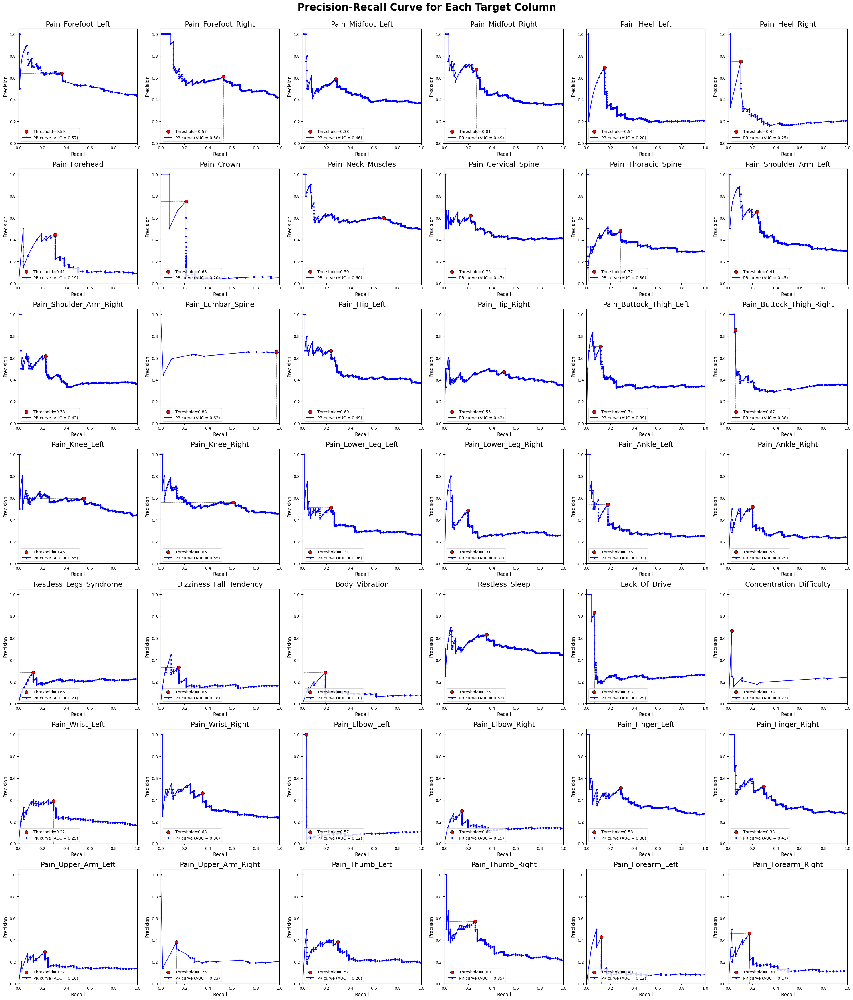

In [122]:
## 12. Precision-Recall Curve Plots 
pr_curves_fig = plot_precision_recall_curves(best_trials, dataset.target_columns)
# plt.close()

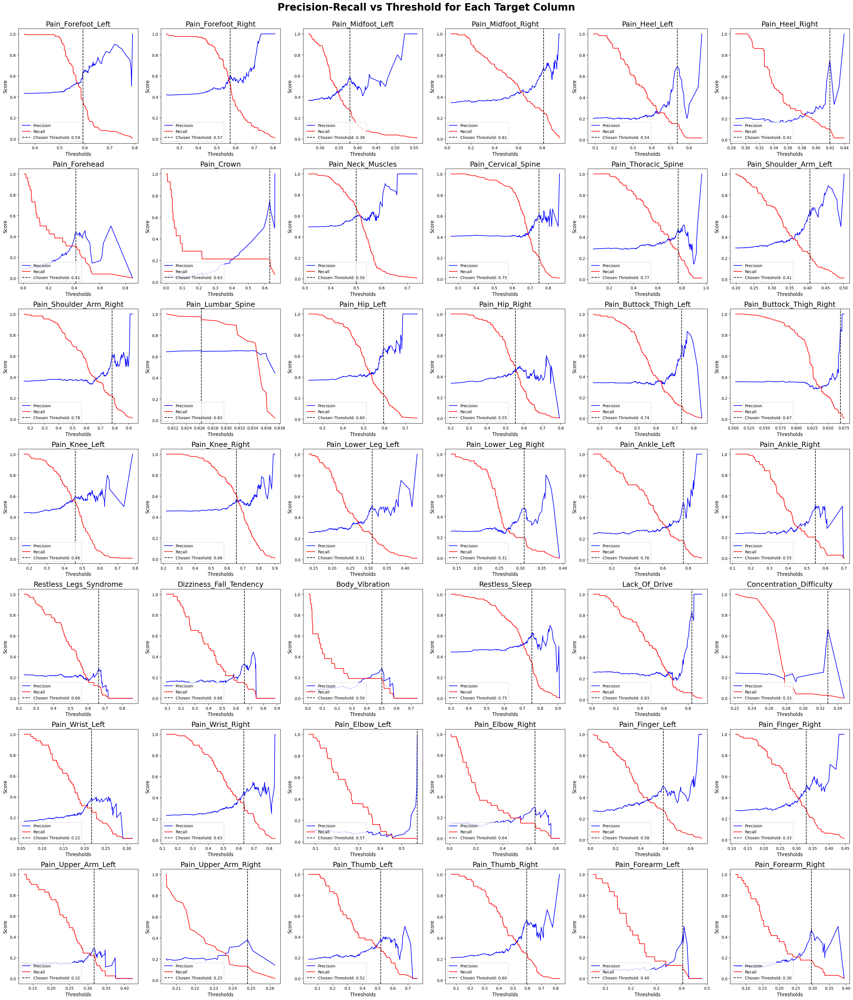

In [123]:
## 13. Threshold vs Precision-Recall Curve Plots 
threshold_pr_curves_fig = plot_thresholds_vs_precision_recall(best_trials, dataset.target_columns)
# plt.close()

- **Model Performance Analysis (Test Data)**
    - Confusion Matrix

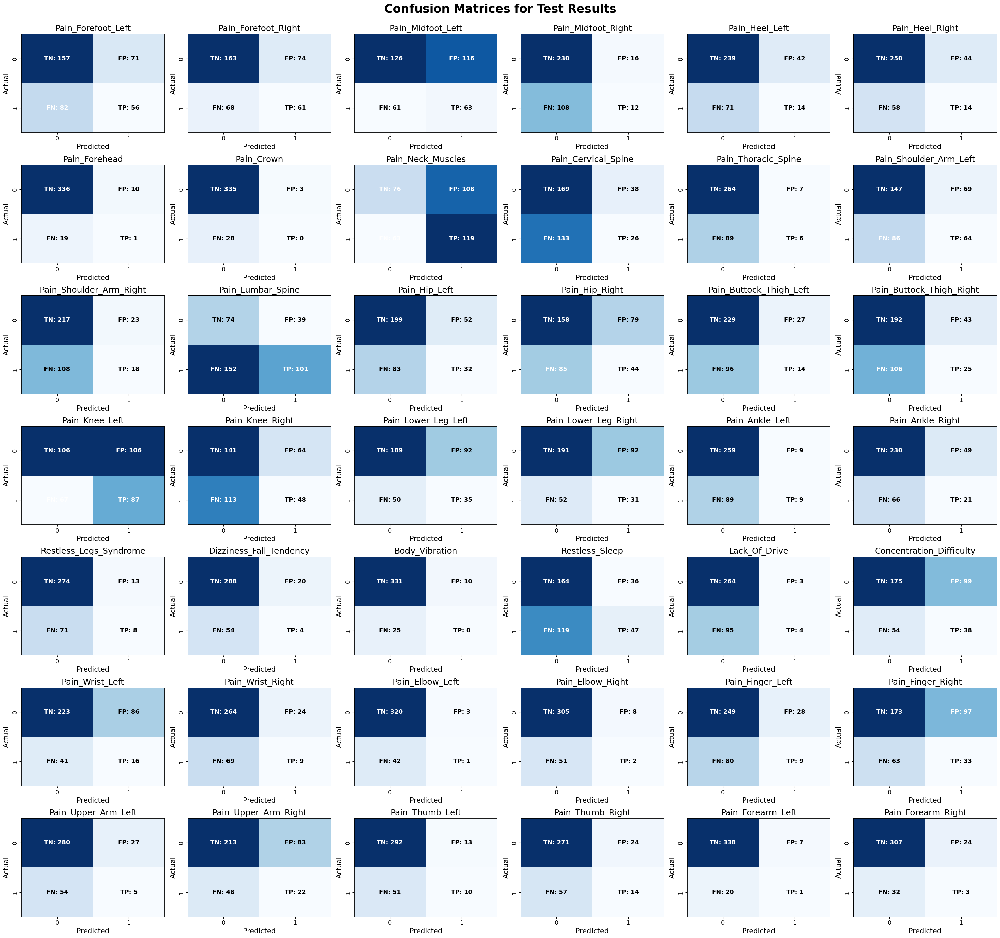

In [124]:
## 14. Confusion Matrix Plots ( Test Data )                             
confusion_matrix_fig = plot_confusion_matrices(y_test_values, y_pred_values, dataset.target_columns) 
# plt.close()

- **Feature / Hyperparameter Importance Analysis**
    - Feature Importance Plot ( Based on Information Gain )
    - Hyperparameter Importance Plot (Optuna)

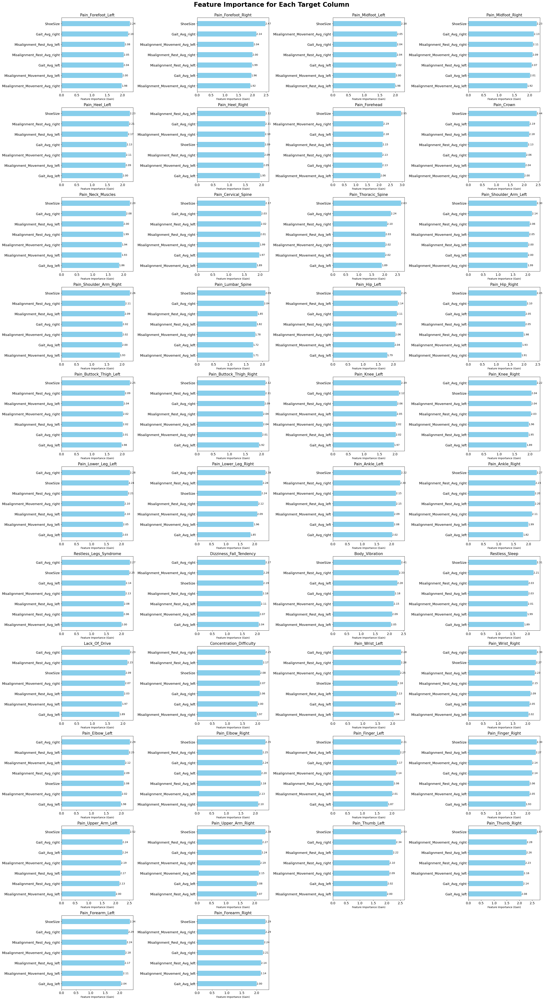

In [125]:
## 15. Feature Importance Analysis ( Final Model, XGBoost Feature Importance )
plot_feature_importance_fig = plot_feature_importance(final_xgb_multi_clf, dataset) 
# plt.close()

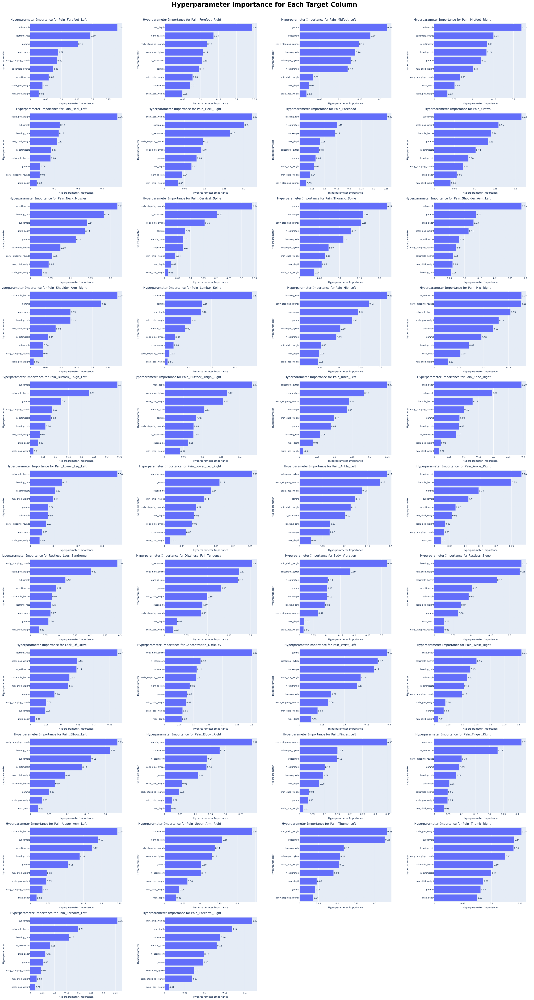

In [126]:
## 16. Hyperparameter Importance Plots 
plot_hyperparameter_importance_fig = plot_hyperparameter_importance(studies, dataset.target_columns)
# plt.close()

- **Impact of Feature Values on the Predictions**
    - SHAP - Summary Plot
    - SHAP - Summary Plot (Data within 1st and 3rd quantile)
    - SHAP - Dependence Plot

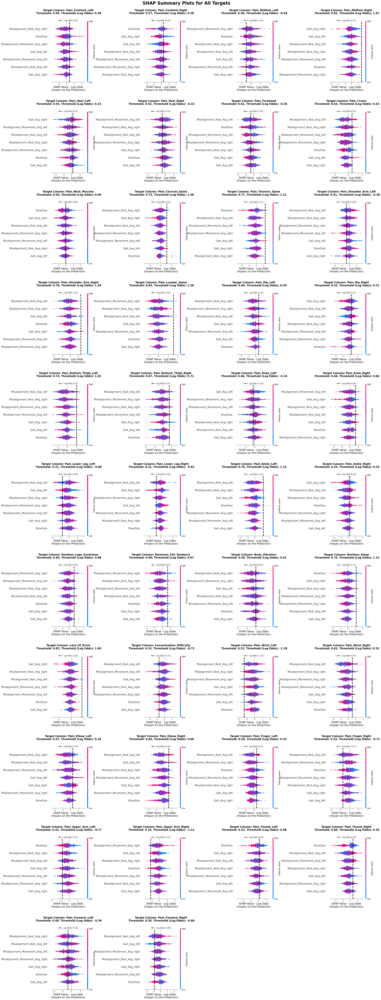

In [127]:
## 17. SHAP Summary Plot (Feature Impact on the Prediction (log odds)) 
SHAP_summary_plot_fig = plot_shap_summary(dataset, final_xgb_multi_clf, best_trials)
# plt.close()

In [128]:
## 18. SHAP Summary Plot (Data within 1st and 3rd quantile)
# plot_shap_IQR_summary_fig = plot_shap_IQR_summary(dataset, final_xgb_multi_clf, best_trials)
# plt.close()

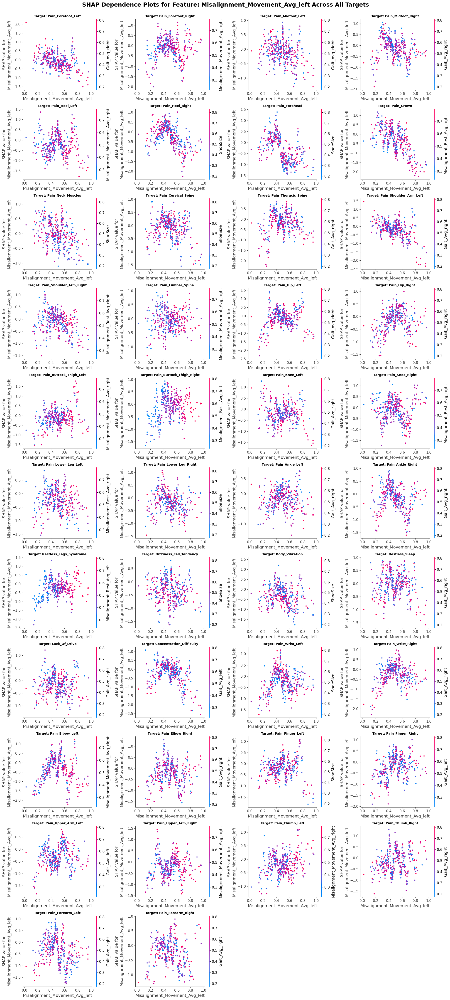

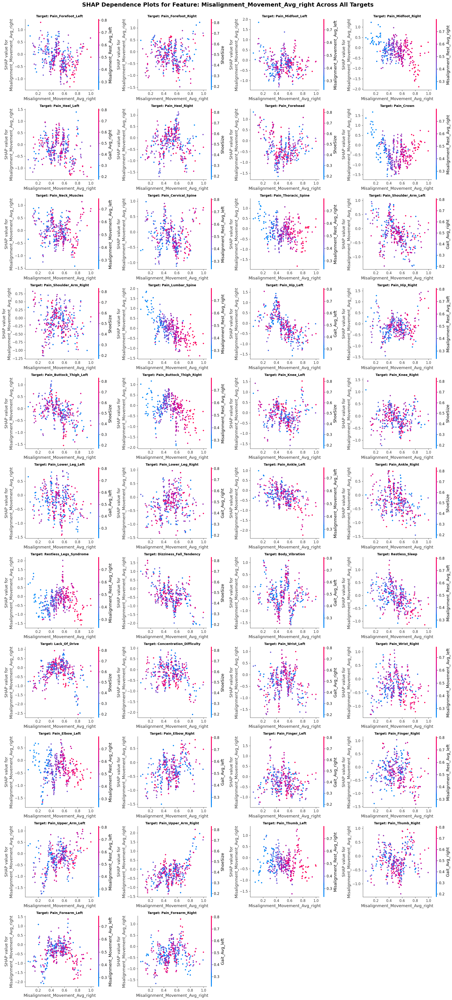

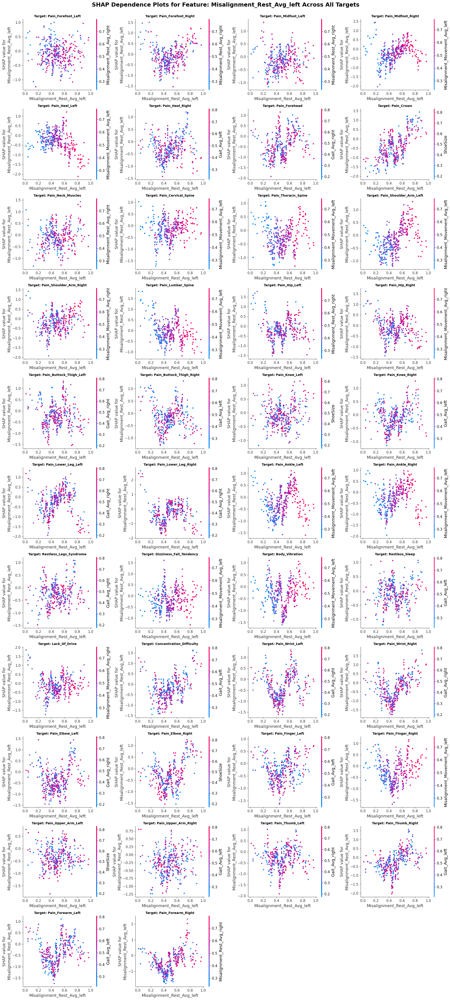

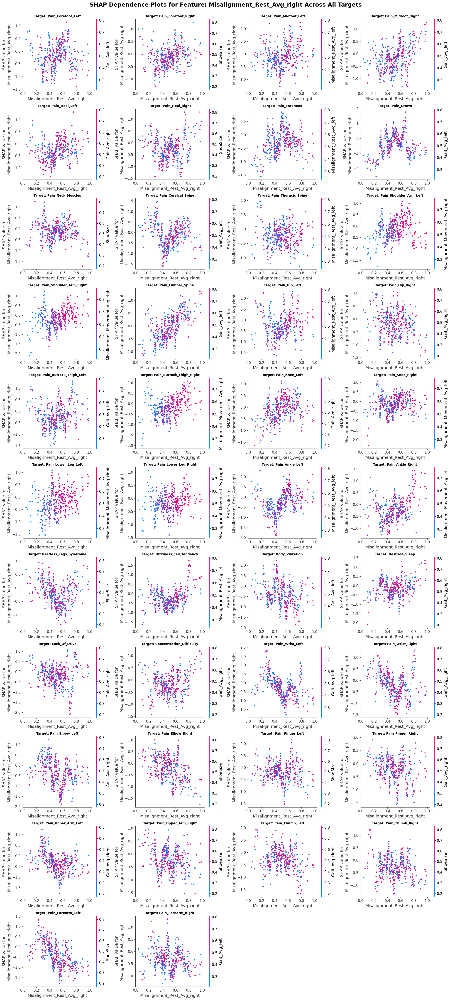

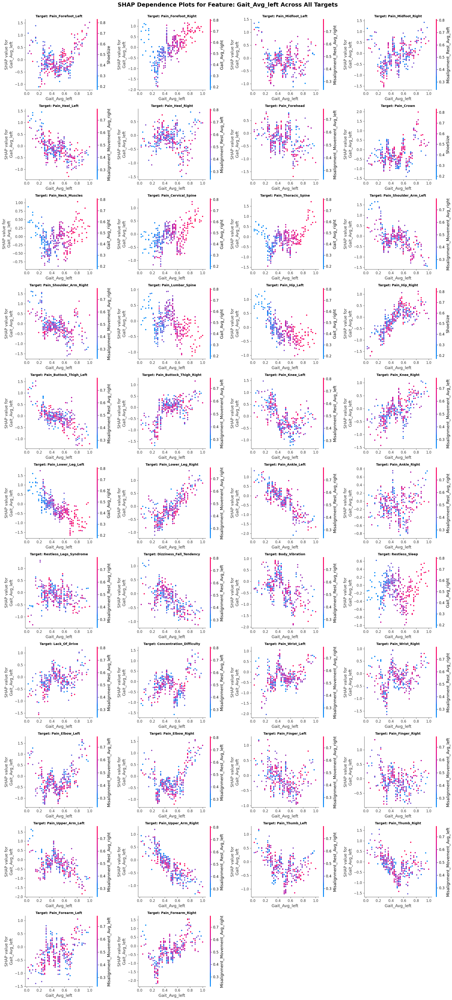

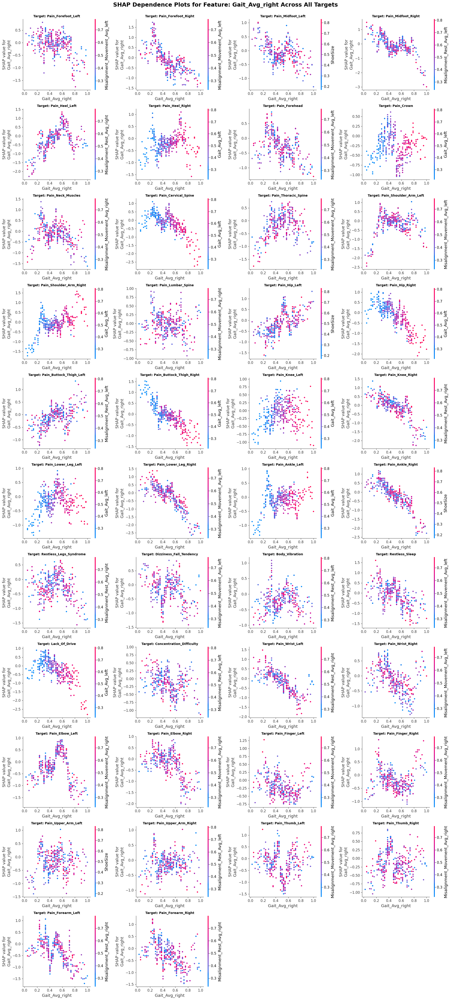

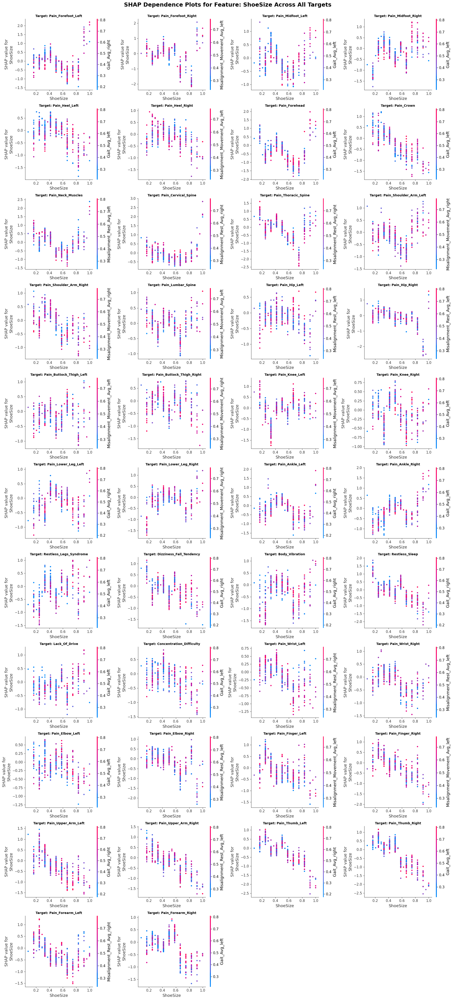

In [129]:
## 19. SHAP Dependence Plots
plot_shap_dependence_plots_fig = plot_shap_dependence_plots(dataset, final_xgb_multi_clf, dataset.feature_columns)
# plt.close()

#### SHAP Analysis
- Differences between XGBoost Feature Importance and SHAP Summary Plot

| Difference                | XGBoost Feature Importance                                      | SHAP Summary Plot                                           |
|---------------------------|-----------------------------------------------------------------|-------------------------------------------------------------|
| Analysis Basis            | How often the model uses the feature (Weight/Gain/Cover)        | Contribution of each feature to the prediction for each sample |
|                           | Importance is calculated across the entire model, not for specific samples. |  |
| Non-linear Relationship   | ❌ Not reflected (Tree-based importance)                        | ✅ Reflected (Explains non-linear relationships)             |
| Individual Prediction Impact | ❌ Based on the entire model                                  | ✅ Can analyze predictions for each sample                   |
| Directional Information   | ❌ None (Simple importance)                                     | ✅ Present (SHAP Value indicates positive/negative impact)   |
| Correlation Issue         | ✅ Only one feature with high correlation might have high importance | ✅ Measures contribution of highly correlated features individually |
| Interpretation Method     | Features with high importance are frequently used by the model  | Analyzes how features increase/decrease prediction values   |
